# 1. Install 7z and extract datasets

In [1]:
# Install 7z
!apt-get install -y p7zip

# Extract datasets
!7z x -y MAXZEGA.7z
!7z x -y IZ0CVY.7z
!7z x -y SV2HWM.7z
#!7z x -y IU8QAI.7z

### Merge all datasets in a huge one
## Currently not used
##!if [ ! -f MERGED.csv ]; then cp MAXZEGA.csv MERGED.csv; tail -n +2 IZ0CVY.csv >> MERGED.csv; tail -n +2 SV2HWM.csv >> MERGED.csv; fi

Reading package lists... Done
Building dependency tree       
Reading state information... Done
p7zip is already the newest version (16.02+dfsg-6).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 95857562 bytes (92 MiB)

Extracting archive: MAXZEGA.7z
--
Path = MAXZEGA.7z
Type = 7z
Physical Size = 95857562
Headers Size = 130
Method = BZip2
Solid = -
Blocks = 1

  0%      2% - MAXZEGA.csv                    4% - MAXZEGA.csv                    7% - MAXZEGA.csv                   10% - MAXZEGA.csv                   12% - MAXZEGA.csv     

# 2. Import the dataset and load libraries

In [1]:
# Set the station callsign
CALLSIGN = "MAXZEGA"

# Import libraries
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.pyplot import figure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

df = pd.read_csv('/content/' + CALLSIGN + '.csv', sep=';')

# Ignore strong signals to avoid biases
df = df.query("(snr > 0) | (snr < 70)")

# Remove unused (test) columns
df = df.drop('tx_pow', axis='columns')
df = df.drop('rec_pow', axis='columns')

## 2.1 Check the dataset format

In [3]:
df.head(10)

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
0,41.66827,12.45356,2275.4,1.44,176.71,70.3,8.4,6.0,7.2,128.1,-273.0,-1.0,-1.0
1,41.66743,12.45469,2353.4,1.50,176.64,70.4,9.3,7.7,12.8,141.9,-273.0,-1.0,-1.0
2,41.66717,12.45491,2371.4,1.51,176.62,70.5,9.9,7.1,9.3,147.1,-273.0,-1.0,-1.0
3,41.66710,12.45497,2377.6,1.52,176.62,70.5,9.9,6.4,8.6,139.6,-273.0,-1.0,-1.0
4,41.66704,12.45505,2383.1,1.52,176.61,70.5,9.0,5.0,9.7,130.6,-273.0,-1.0,-1.0
5,41.66698,12.45515,2388.7,1.53,176.61,70.5,8.9,6.7,11.8,126.3,-273.0,-1.0,-1.0
6,41.66643,12.45595,2433.0,1.56,176.56,70.6,10.9,6.0,9.9,123.7,-273.0,-1.0,-1.0
7,41.66638,12.45605,2438.5,1.57,176.55,70.6,10.8,5.5,10.6,120.8,-273.0,-1.0,-1.0
8,41.66627,12.45627,2449.6,1.57,176.54,70.6,10.2,7.0,12.4,129.0,-273.0,-1.0,-1.0
9,41.66599,12.45661,2466.5,1.59,176.51,70.6,10.1,6.2,15.2,148.4,-273.0,-1.0,-1.0


## 2.2 Check the dataset initial statistics

In [4]:
df.describe()

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
count,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06
mean,4.210061e+01,1.256262e+01,1.813788e+04,8.880707e+00,1.847788e+02,1.346245e+02,1.458357e+01,4.609758e-02,1.756067e+01,1.368936e+02,-5.032971e+01,1.182207e+01,1.184640e+01
std,1.063755e+00,1.137396e+00,9.217938e+03,7.389827e+00,7.763717e+01,7.584136e+01,3.975513e+00,1.065985e+01,1.214361e+01,7.726429e+01,3.111094e+01,2.086772e+01,4.597079e+01
min,3.916920e+01,7.721560e+00,3.898000e+02,1.600000e-01,0.000000e+00,1.250000e+01,-2.000000e-01,-1.337000e+02,0.000000e+00,0.000000e+00,-2.730000e+02,-1.000000e+00,-1.000000e+00
25%,4.149547e+01,1.222952e+01,1.054080e+04,3.770000e+00,1.396800e+02,7.640000e+01,1.150000e+01,-3.000000e-01,8.900000e+00,8.250000e+01,-5.920000e+01,1.200000e+00,-1.000000e+00
50%,4.171277e+01,1.260628e+01,1.786600e+04,6.740000e+00,1.677800e+02,1.092000e+02,1.440000e+01,4.500000e+00,1.470000e+01,1.128000e+02,-5.480000e+01,1.800000e+00,-1.000000e+00
75%,4.212912e+01,1.306472e+01,2.547050e+04,1.198000e+01,1.914300e+02,1.782000e+02,1.730000e+01,5.500000e+00,2.290000e+01,1.784000e+02,-4.280000e+01,1.060000e+01,-1.000000e+00
max,4.650279e+01,1.802704e+01,3.800030e+04,8.311000e+01,3.600000e+02,5.112000e+02,3.360000e+01,8.010000e+01,1.087000e+02,3.600000e+02,3.140000e+01,1.000000e+02,8.941000e+02


# 3. Run preliminary analysis on the dataset

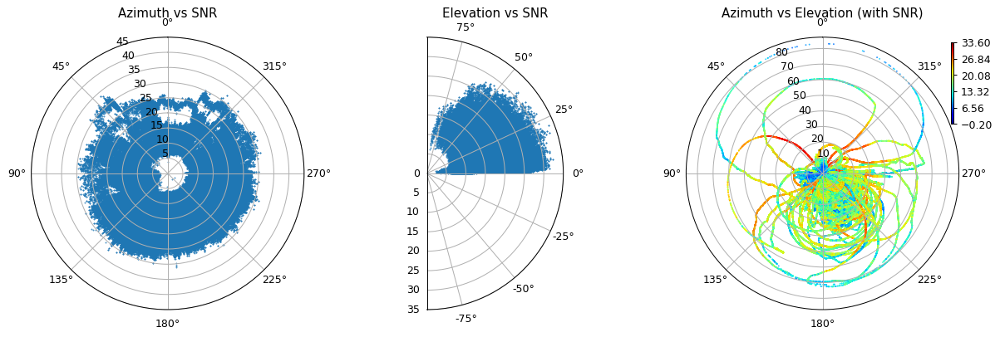

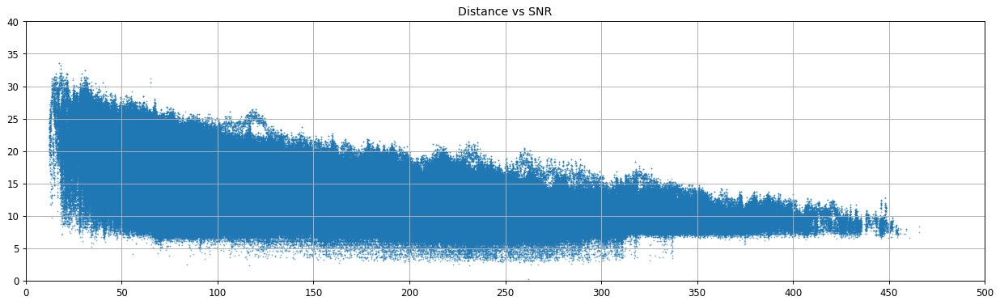

In [20]:
ddf = df

fig = plt.figure(figsize=(16, 16))
fig.set_dpi(90)

# AZIMUTH vs SNR
ax1 = plt.subplot(1,3,1, projection = 'polar')
ax1.set_theta_zero_location("N")
ax1.scatter(-np.deg2rad(ddf.azimuth), ddf.snr, s=0.2, cmap='jet')
plt.ylim(0, 45)
# ax1.set_xlabel('azimuth', fontsize = 20, labelpad = 20)
ax1.set_title('Azimuth vs SNR')

# ELEVATION vs SNR
ax2 = fig.add_subplot(1,3,2, projection='polar', xlim=(0, 90))
ax2.set_theta_zero_location("N")
ax2.set_thetamin(-90) # set the limits
ax2.set_thetamax(90)
ax2.set_theta_offset(np.deg2rad(0)) # point the origin towards the top
plt.ylim(0, 35)
# ax2.set_thetagrids(range(-90, 120, 30)) # set the gridlines
ax2.scatter(np.deg2rad(ddf.elevation), ddf.snr, s=0.2, cmap='jet')
# plt.ylim(0, 45)
ax2.set_title('Elevation vs SNR')

# AZIMUTH vs ELEVATION with SNR
ax3 = fig.add_subplot(1,3,3, projection='polar')
ax3.set_theta_zero_location("N")
# Create chart
plot = ax3.scatter(-np.deg2rad(ddf['azimuth']), ddf['elevation'], s=0.2, c=ddf['snr'], cmap='jet')
ax3.set_title('Azimuth vs Elevation (with SNR)')
# Create legend
cbaxes = inset_axes(ax3, width="1%", height="30%", loc=1)
plt.colorbar(plot, cax=cbaxes, orientation='vertical', ticks=np.linspace(ddf['snr'].min(), ddf['snr'].max(), 6))
# Show chart
plt.show()


# DISTANCE vs SNR
fig = plt.figure(figsize=(18, 5))
fig.set_dpi(85)
ax3 = fig.add_subplot(1,1,1)
plt.grid()
plt.scatter(ddf.distance, ddf.snr, s=0.1)
plt.xlim(0, 500)
plt.ylim(0, 40)
# ax3.set_xlabel('distance', fontsize = 20, labelpad = 20)
ax3.set_title('Distance vs SNR')
ax3.set_xticks(np.linspace(0,500,11))
plt.show()

# # produce a legend with the unique colors from the scatter
# legend1 = ax.legend(*scatter.legend_elements(),
#                     loc="lower left", title="Classes")
# ax.add_artist(legend1)

# ax3 = fig.add_subplot(111, projection = '3d')
# # ax3.set_theta_zero_location("N")
# plot = ax3.scatter(ddf.distance, ddf.snr, s=0.2, cmap='jet')
# ax3.set_xlabel('distance', fontsize = 20, labelpad = 20)
# ax3.set_title('Distance vs snr')

# 4. Check the correlation matrix map

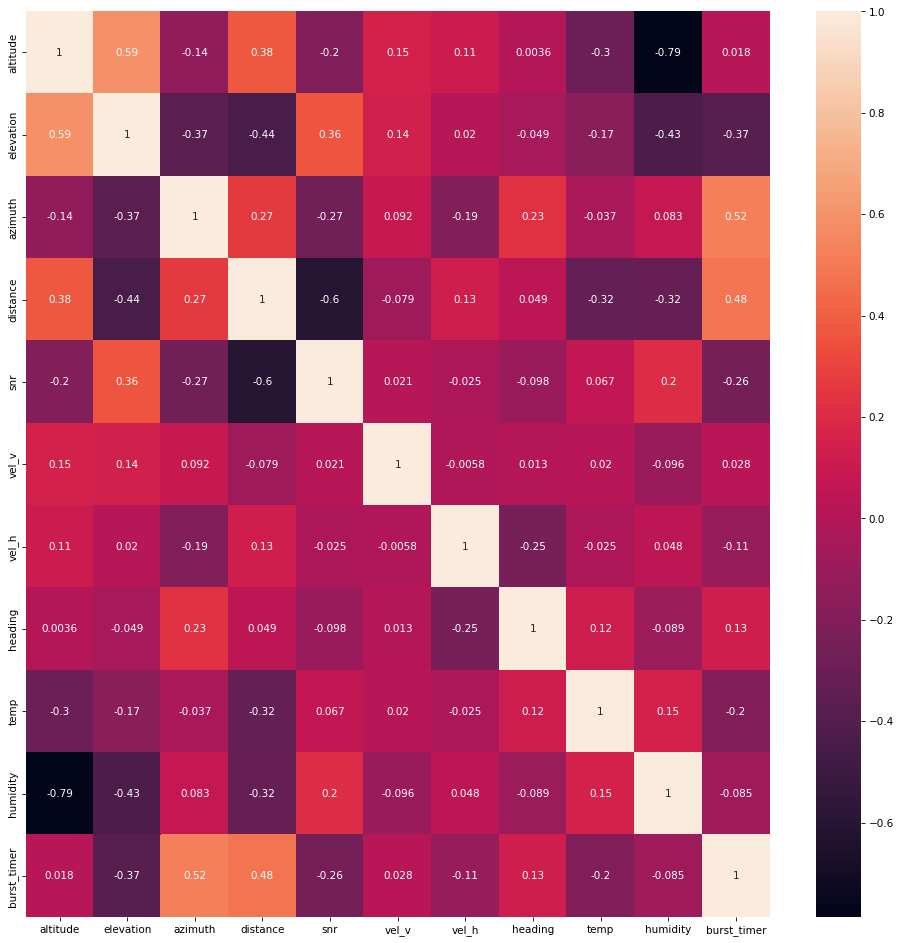

In [21]:
# Copy the dataframe, and drop unused columns
ddf = df
ddf = ddf.drop('latitude', axis='columns')
ddf = ddf.drop('longitude', axis='columns')
#ddf = ddf.drop('tx_pow', axis='columns')
#ddf = ddf.drop('rec_pow', axis='columns')
fig = plt.figure(figsize=(16, 16))
fig.set_dpi(75)

# Create the correlation matrix
corr_matrix = ddf.corr(method='spearman')
sn.heatmap(corr_matrix, annot=True)

# Show the correlation matrix
plt.show()

# 5. Calculate basic statistics of the data

In [5]:
# Copy the dataframe
ddf = df
ddf.describe()

,latitude,longitude,altitude,elevation,azimuth,distance,snr,vel_v,vel_h,heading,temp,humidity,burst_timer
count,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06,5.024064e+06
mean,4.210061e+01,1.256262e+01,1.813788e+04,8.880707e+00,1.847788e+02,1.346245e+02,1.458357e+01,4.609758e-02,1.756067e+01,1.368936e+02,-5.032971e+01,1.182207e+01,1.184640e+01
std,1.063755e+00,1.137396e+00,9.217938e+03,7.389827e+00,7.763717e+01,7.584136e+01,3.975513e+00,1.065985e+01,1.214361e+01,7.726429e+01,3.111094e+01,2.086772e+01,4.597079e+01
min,3.916920e+01,7.721560e+00,3.898000e+02,1.600000e-01,0.000000e+00,1.250000e+01,-2.000000e-01,-1.337000e+02,0.000000e+00,0.000000e+00,-2.730000e+02,-1.000000e+00,-1.000000e+00
25%,4.149547e+01,1.222952e+01,1.054080e+04,3.770000e+00,1.396800e+02,7.640000e+01,1.150000e+01,-3.000000e-01,8.900000e+00,8.250000e+01,-5.920000e+01,1.200000e+00,-1.000000e+00
50%,4.171277e+01,1.260628e+01,1.786600e+04,6.740000e+00,1.677800e+02,1.092000e+02,1.440000e+01,4.500000e+00,1.470000e+01,1.128000e+02,-5.480000e+01,1.800000e+00,-1.000000e+00
75%,4.212912e+01,1.306472e+01,2.547050e+04,1.198000e+01,1.914300e+02,1.782000e+02,1.730000e+01,5.500000e+00,2.290000e+01,1.784000e+02,-4.280000e+01,1.060000e+01,-1.000000e+00
max,4.650279e+01,1.802704e+01,3.800030e+04,8.311000e+01,3.600000e+02,5.112000e+02,3.360000e+01,8.010000e+01,1.087000e+02,3.600000e+02,3.140000e+01,1.000000e+02,8.941000e+02


# 6. Generate pairplots

### Pairplots for altitude <= 14.000m

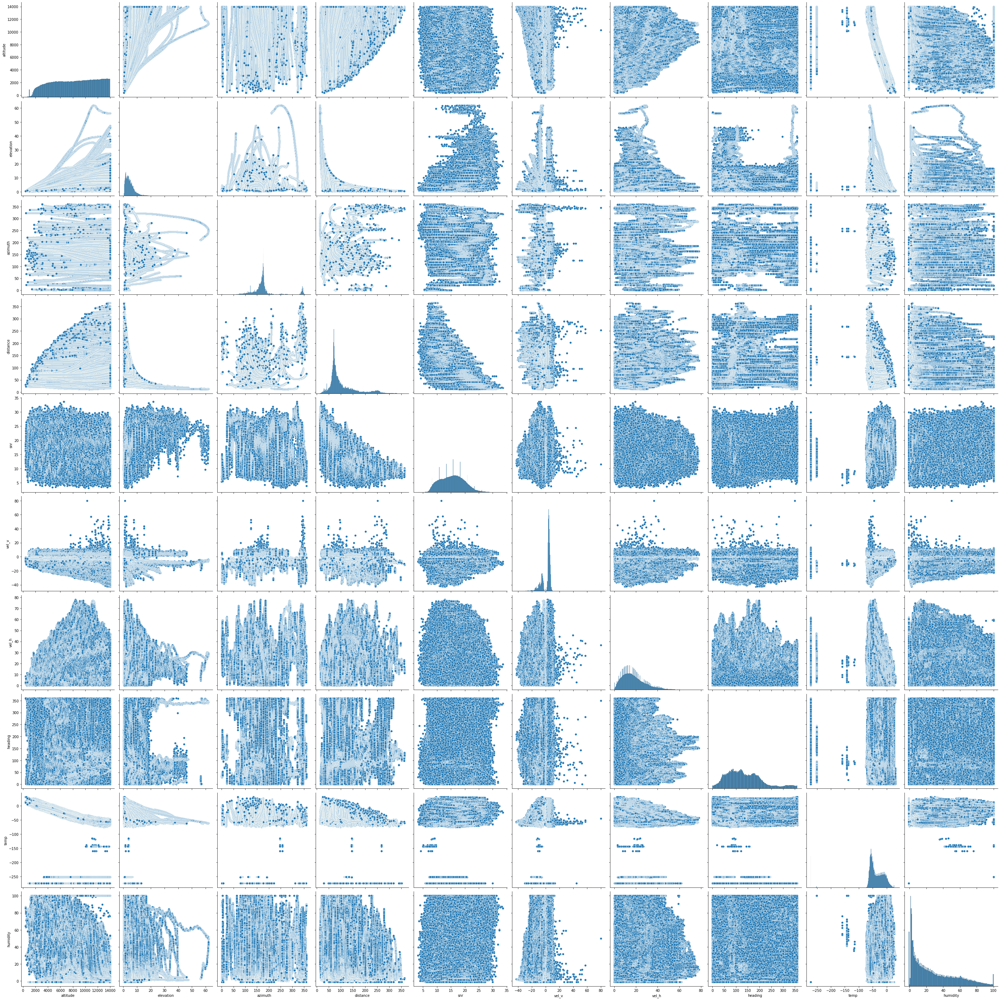

In [23]:
# Filter results to examine the lower atmosphere
ddf = df.query('altitude <= 14000')

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig("/content/sns_pairplot_" + CALLSIGN + "_14000-.png")

### Pairplots for altitude >= 20.000m

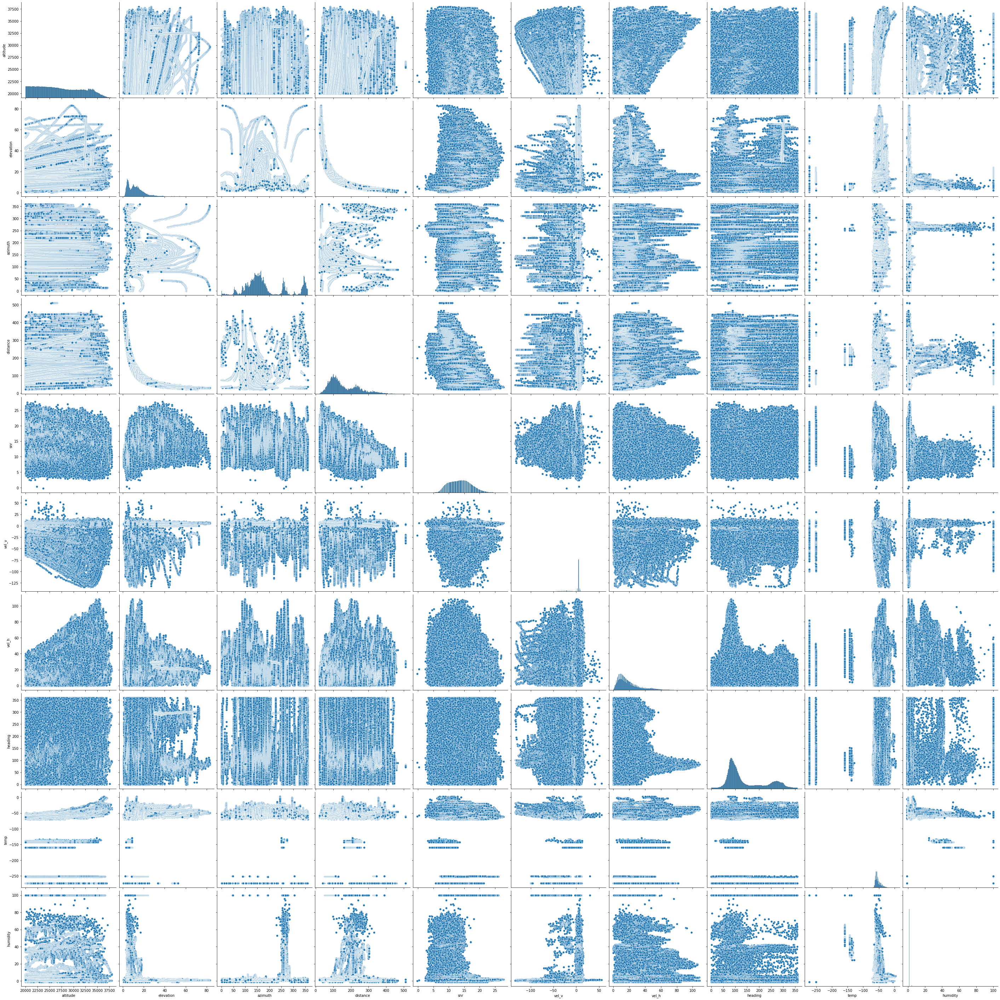

In [6]:
# Filter results to examine the higher atmosphere
ddf = df.query('altitude >= 20000')

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig("/content/sns_pairplot_" + CALLSIGN + "_20000+.png")

### Pairplot for all altitudes (full range)

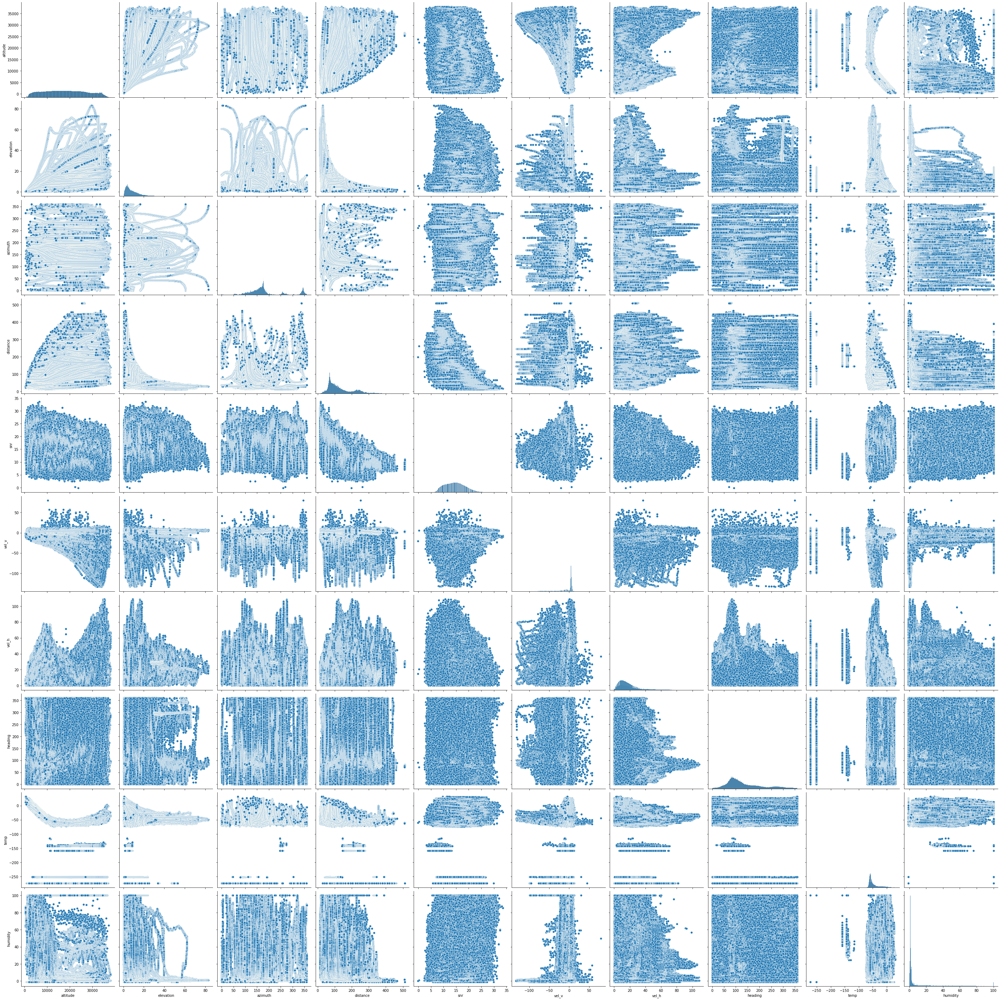

In [2]:
# Filter results to examine the lower atmosphere
ddf = df

## when running locally, limit the ram usage to avoid crashes.
#ddf = ddf.head(150000)
cols = ['altitude', 'elevation', 'azimuth', 'distance', 'snr', 'vel_v', 'vel_h', 'heading', 'temp', 'humidity']
sns_plot = sn.pairplot(ddf[cols], height=4.0)

sns_plot.savefig("/content/sns_pairplot_" + CALLSIGN + "_fullrange.png")